# Problema 1 (escalón)


### Condición inicial dada por el paper

$$
u(x,0)=
\frac{1}{2} \cdot \left[1 - \tanh\left(\frac{x - 25}{5}\right) \right]
$$

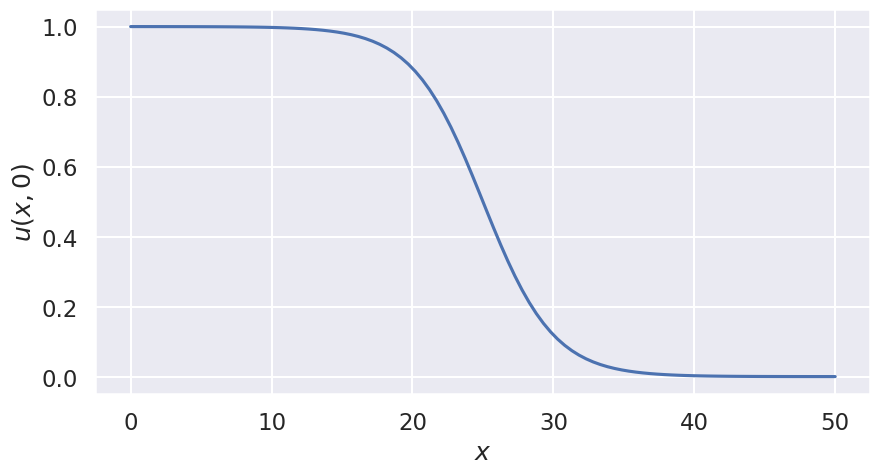

In [ ]:
def f1(x):
  return (1 - np.tanh((x - 25) / 5)) / 2

x = np.linspace(0, 50, 100)

fig, ax = plt.subplots(figsize=(10, 5))
ax.plot(x, f1(x))
ax.set_xlabel(r"$x$")
ax.set_ylabel(r"$u(x,0)$")
plt.show()

### Solución numérica

Forma en diferencias finitas de la ecuacion de KdeV:


\begin{eqnarray}
  u(i, j+1) &\approx& u(i,j-1)-\frac{\epsilon}{3}\frac{\Delta t}{\Delta x}\left[ u(i+1,j) + u(i,j) + u(i-1,j) \right] \times \left[ u(i+1,j) - u(i-1,j)\right] \\
  &&- \mu\frac{\Delta t}{(\Delta x)^3} \times \left[ u(i+2,j) + 2u(i-1,j) - 2u(i+1,j) - u(i-2,j) \right]
\end{eqnarray}

Notese que esta forma en diferencias finitas no se encuentra definida para todos los puntos del plano Posicion $\times$ Tiempo, pues en cuanto a la dimension temporal se requiere conocimiento de los dos instantes anteriores al punto a calcular, mientras que en la dimension espacial se requiere conocimiento de los dos puntos tanto a derecha como a izquierda del punto a calcular. Esto implica que la anterior forma para la ecuacion de KdeV no se encuentra definida paralos siguientes conjuntos de puntos:

\begin{eqnarray}
  u(x_0, t) \quad &\text{,}& \quad \forall t \in [t_0,t_f] \\
  u(x_0 + \Delta x, t) \quad &\text{,}& \quad \forall t \in [t_0,t_f] \\
  u(x_f - \Delta x, t) \quad &\text{,}& \quad \forall t \in [t_0,t_f] \\
  u(x_f, t) \quad &\text{,}& \quad \forall t \in [t_0,t_f] \\
  u(x, t_0 + \Delta t) \quad &\text{,}& \quad \forall x \in [x_0, x_f]
\end{eqnarray}

En cuanto al conjunto de puntos $u(x, t_0 + \Delta t)$, se les asignaron los mismos valores de la condicion inicial, es decir:

\begin{equation}
  u(x, t_0 + \Delta t) = u(x, t_0) \quad \text{,} \quad \forall x \in [x_0, x_f]
\end{equation}

Para las otras columnas de puntos, se realizaron las siguientes asignaciones de valores:
\begin{eqnarray}
  u(x_0, t) = u(x_0 + \Delta x, t) &=& u(x_0,t_0) \\
  u(x_f,t) = u(x_f - \Delta x, t) &=& u(x_f,t_0)
\end{eqnarray}

El valor de estos conjuntos de puntos en la malla no se actualizan en vista de que se esta trabajando con intervalos de tiempo y espacio tales que el soliton no se propague por fuera de la region determinada, de modo que se cumplen las siguientes aproximaciones dada la condicion inicial $u(x,0)$ definida previamente:
\begin{eqnarray}
  u(x_0, t) = u(x_0 + \Delta x, t) &\approx& 1 \\
  u(x_f,t) = u(x_f - \Delta x, t) &\approx& 0
\end{eqnarray}

La condicion de estabilidad para este metodo es la siguiente:
\begin{equation}
  \frac{\Delta t}{\Delta x} \left[ \epsilon |u| + 4\frac{\mu}{(\Delta x)^2} \right] \leq 1
\end{equation}

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def setup_problem(dx, dt, xmin, xmax, tmin, tmax):
    X = np.arange(xmin, xmax + dx, dx)
    T = np.arange(tmin, tmax + dt, dt)
    return X, T

def bc(U, X, f_inicial):
    U[:, 0] = f_inicial(X)
    U[:, 1] = f_inicial(X)
    U[0:2,:] = f_inicial(X)[0]
    U[-2:,:] = f_inicial(X)[-1]

def check_stability(dx, dt, eps, mu, U):
    max_u = np.max(np.abs(U))
    stability_condition = (dt / dx) * (eps * max_u + 4 * (mu / dx**2))
    return stability_condition <= 1

def KdeV(U, dx, dt, eps, mu):
    U[2:-2, 2:] = U[2:-2, 0:-2] - (eps * dt) / (3 * dx) * (U[3:-1, 1:-1] + U[2:-2, 1:-1] + U[1:-3, 1:-1]) * (U[3:-1, 1:-1] - U[1:-3, 1:-1])\
     - (mu * dt) / (dx)**3 * (U[4:, 1:-1] + 2 * U[1:-3, 1:-1] - 2 * U[3:-1, 1:-1] - U[0:-4, 1:-1])

def solve_system(niter, dx, dt, xmin, xmax, tmin, tmax, eps, mu, iter_method, f_inicial):
    X, T = setup_problem(dx, dt, xmin, xmax, tmin, tmax)
    U = np.zeros((len(X), len(T)))
    bc(U, X, f_inicial)

    if not check_stability(dx, dt, eps, mu, U):
        raise ValueError("El sistema no es estable con los parámetros proporcionados.")

    for step in range(niter):
        iter_method(U, dx, dt, eps, mu)

    X, T = np.meshgrid(X, T, indexing='ij')
    return X, T, U

X, T, U = solve_system(niter=2000, dx=0.4, dt=0.1, xmin=0.0, xmax=50.0, tmin=0.0, tmax=200.0,  eps=0.2, mu=0.1, iter_method=KdeV, f_inicial=f1)

plot_3d_interactive(X, T, U)


<ipython-input-15-cfdc0951e048>:21: RuntimeWarning:

overflow encountered in multiply

<ipython-input-15-cfdc0951e048>:21: RuntimeWarning:

invalid value encountered in add

<ipython-input-15-cfdc0951e048>:21: RuntimeWarning:

invalid value encountered in subtract

<ipython-input-15-cfdc0951e048>:22: RuntimeWarning:

invalid value encountered in add

<ipython-input-15-cfdc0951e048>:22: RuntimeWarning:

invalid value encountered in subtract

<ipython-input-15-cfdc0951e048>:22: RuntimeWarning:

overflow encountered in multiply



### Animación

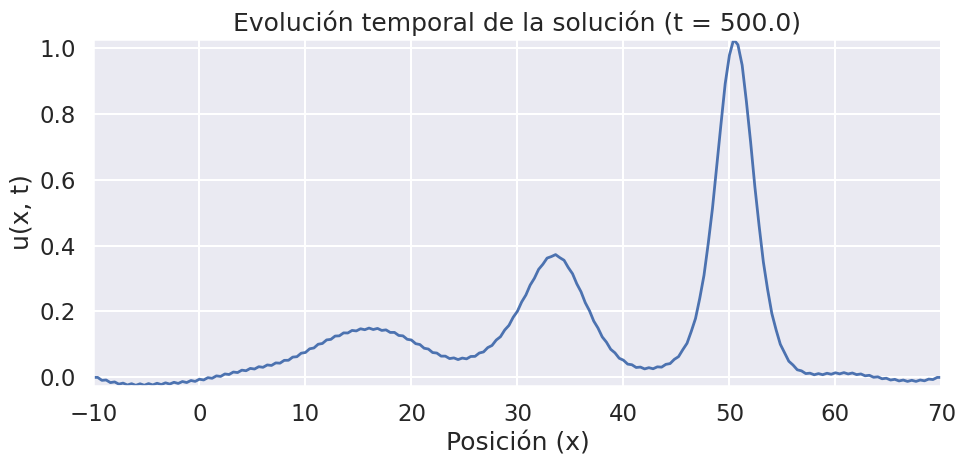

In [ ]:
animate_solution(X, T, U, timestep=10)